# Purpose
1. To see the summary of PPG, Capnography, "Ground Truth", and RR estimation candidates of a single subject
2. To zoom in on the algorithm details of one specific PPG segment, for inspecting and debugging.

In [6]:
from ppg2rr.rr_est import estimate_rr
from ppg2rr.config import AlgorithmParams
import pandas as pd

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
# pd.set_option('display.precision', 2)
pd.set_option('display.float_format', lambda x: f'{x:.2f}')  # no scientific notation; 2 decimal places

In [7]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Settings for the entire notebook

In [8]:
# lowpass_ppg = 20      # default: dynamic
lowpass_ppg = "dynamic"

# The find_peaks() parameter used in peak_counting_analysis() of RIVs. The default
# value is 0.5, based on the assumption that the RIV has been normalized to have
# a mean of 0 and standard deviation of 1.
# peak_counting_prominence = 0.5

# The following are not standardized across this notebook: 
#   rr_seed

In [9]:
# dataset = 'capnobase'
# dataset = 'kapiolani'
# dataset = 'mimic'
# dataset = 'vortal'
dataset = '3ps'

# For CapnoBase, the trial number is the index of the files sorted by filename; the participant ID is the first part of each filename
# trial = 4       # Participant 0023. Smooth, steady capnography. Good PPG. 3 y.o., spontaneous breathing.
# trial = 8       # Participant 0031. 7 y.o. Erratic capnography, but PPG shows matching baseline wander.
# trial = 24      # Participant 0142, 5 y.o., spontaneous breathing. Capno RR is steadily 15 rpm, but PPG-RR struggles.
# trial = 15      # Participant 0115. PPG has problems but no marked artifacts. HR estimate not reliable at times.
# trial = 25       # Has marked artifacts for both PPG and CO2. Big HR disagreement during low-quality, flatline PPG.
# trial = 0       # Participant 0009. No artifacts, but long, big HR disagreement when HR estimate was deemed not reliable.
# trial = 2       # Participant 0016. 2 y.o., ventilated with good capno and clean PPG but terrible PPG RR estimates.

# Vortal
# trial = 33      # Strong dicrotic notch. Very noisy ONP; how did the authors detect breaths? High RR/HR, above Nyquist.
# trial = 13      # High RR/HR (Nyquist)
# trial = 15      # 4 frames cannot be estimated
# trial = 28      # Most frames cannot be estimated

trial = 0

# View results of all frames from a single subject

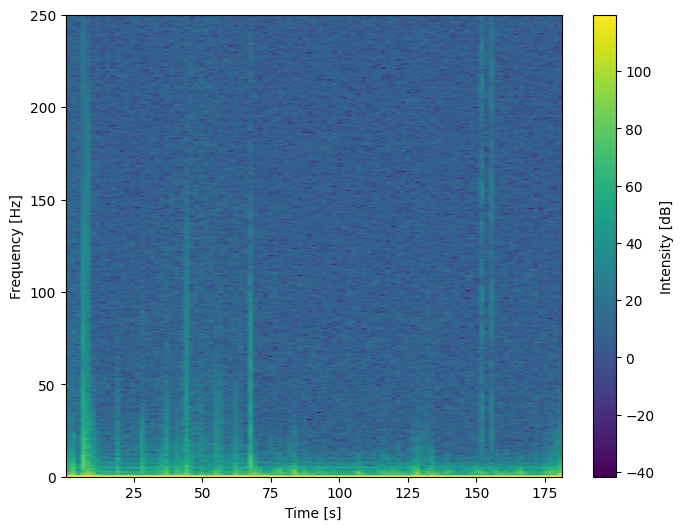

In [10]:
# The number of frames are printed out to help pinpoint the location of failure.

params = AlgorithmParams(
    dataset=dataset,
    probe=1,            # For Kapiolani
    probe_type="Tr",    # for 3ps, "Tr" or "Re"
    led_num=1,          # for 3ps, 1 or 2
    lowpass_cutoff_ppg = lowpass_ppg,
    window_size = 30,
    window_increment = 5,
    )

(
    frame_data_all,
    rr_candidate_merged,
    all_rr_candidates_list,
    feature_quality_list,
    meta,
    trial_summary_df
) = estimate_rr(
    trial_num=trial,
    frame_num=None,
    params=params,
    dataset=dataset,
    show=True,
    fig_large=False,
    save_fig=True,
    save_psd_fig=False,
    save_frame_psd_figs=False,
    show_rr_candidates=True
)

In [11]:
# see statistics about this trial

trial_summary_df

,metric,statistic,value
0,trial,-,0
1,id,-,N07-017
2,local datetime,-,2025-04-14 09:22
3,age,-,1.25
4,weight,-,12
5,gender,-,female
6,ITA mean,-,None
7,ITA SD,-,None
8,complaint,-,OTHER
9,temperature,-,36.2


In [12]:
# put frame data and rr_candidates into a data frame for inspection
results = pd.concat([pd.DataFrame(frame_data_all),pd.DataFrame(rr_candidate_merged)], axis=1)
if params.reference_rr_target_is_nested:
    results.drop(columns=["avg rr ref panelist", "RR ref disagreement panelist (bpm)"], inplace=True)
results

,frame index,time start,time end,RR uncertainty panel (mean),RR uncertainty panelist D (mean),RR uncertainty panelist J (mean),RR uncertainty panelist O (mean),avg rr ref panelist D,RR ref disagreement panelist D (bpm),avg rr ref panelist J,RR ref disagreement panelist J (bpm),avg rr ref panelist O,RR ref disagreement panelist O (bpm),RR ref disagreement panel (bpm),avg rr ref panel,RR ref panel (mean),rr annot post,rr annot live,avg rr ref,RR ref (mean),RR ref disagreement (bpm),RR ref video problems panelist D,RR ref video problems panelist J,RR ref video problems panelist O,RR ref video problems panel,no hr ref,no rr ref,aliased,no ppg,clipping,HR ref (mean),Ref RR/HR (mean),HR estimated (mean),HR est reliable,HR disagreement of means,PPG quality,PPG noise peak f,PPG noise ratio,PPG noise mean Pxx,"PSD, closest to prev RR",PSD median,"Counting, median # peaks","Counting, median pk delta rqi cutoff","Counting, median pk delta std cutoff",kalman,mean of fused candidates,median of fused candidates,mode of fused candidates,simple median,buffered_display
0,0,0,30,0.14,0.00,0.00,0.43,31.57,NaN,29.31,NaN,29.65,NaN,2.26,30.18,30.18,30.18,NaN,30.18,30.18,NaN,,,,,False,False,True,False,False,51.21,0.59,39.20,False,12.01,0.00,32.36,329.29,4737.34,21.80,19.34,11.60,11.22,10.41,19.34,16.36,19.34,20.00,11.28,NaN
1,1,5,35,0.15,0.00,0.00,0.46,32.98,NaN,27.74,NaN,23.43,NaN,9.55,28.05,28.05,28.05,NaN,28.05,28.05,NaN,,,,,False,False,True,False,False,49.37,0.57,36.20,False,13.17,0.00,32.35,469.28,1795.94,18.98,18.98,10.80,9.56,9.39,19.34,15.90,18.98,20.00,10.11,NaN
2,2,10,40,0.15,0.00,0.00,0.46,32.45,NaN,26.96,NaN,19.55,NaN,12.90,26.32,26.32,26.32,NaN,26.32,26.32,NaN,,,,,False,False,True,False,False,51.36,0.51,90.00,False,38.64,0.02,32.73,32.85,16.44,17.41,17.21,16.64,18.48,18.48,17.93,17.87,17.93,20.00,16.88,NaN
3,3,15,45,0.19,0.00,0.00,0.56,28.38,NaN,27.06,NaN,15.86,NaN,12.52,23.77,23.77,23.77,NaN,23.77,23.77,NaN,,,,,False,False,False,False,False,53.75,0.44,97.30,False,43.55,0.12,31.11,51.74,25.91,18.63,18.63,21.70,26.62,26.62,18.28,21.18,18.63,20.00,19.69,NaN
4,4,20,50,0.20,0.00,0.00,0.59,25.93,NaN,26.49,NaN,12.45,NaN,14.04,21.62,21.62,21.62,24.06,22.84,21.62,2.43,,,,,False,False,False,False,False,54.47,0.40,87.80,False,33.33,0.04,31.37,182.29,148.43,17.76,17.76,15.05,18.51,18.51,18.63,18.30,18.51,20.00,17.23,NaN
5,5,25,55,0.20,0.00,0.00,0.59,24.12,NaN,25.85,NaN,12.18,NaN,13.67,20.72,20.72,20.72,24.50,22.61,20.72,3.78,,,,,False,False,False,False,False,61.78,0.34,88.30,False,26.52,0.04,31.05,130.04,110.54,19.69,19.69,17.04,16.80,16.80,16.17,17.56,16.80,15.00,18.98,NaN
6,6,30,60,0.17,0.00,0.00,0.52,24.94,NaN,26.48,NaN,15.76,NaN,10.73,22.39,22.39,22.39,24.61,23.50,22.39,2.22,,,,,False,False,False,False,False,65.59,0.34,80.10,False,14.51,0.00,31.34,139.29,121.02,16.88,16.88,16.20,17.34,17.34,16.17,16.80,16.88,15.00,16.88,NaN
7,7,35,65,0.13,0.00,0.00,0.38,22.79,NaN,27.26,NaN,17.36,NaN,9.90,22.47,22.47,22.47,25.47,23.97,22.47,3.00,,,,,False,False,False,False,False,67.74,0.33,76.00,False,8.26,0.00,31.36,170.58,161.98,19.69,19.69,15.49,19.13,19.13,16.88,18.57,19.13,20.00,18.98,NaN
8,8,40,70,0.13,0.00,0.00,0.38,22.87,NaN,29.74,NaN,17.27,NaN,12.47,23.29,23.29,23.29,25.33,24.31,23.29,2.04,,,,,False,False,False,False,False,69.56,0.33,73.40,False,3.84,0.00,31.37,171.19,180.00,17.76,17.76,13.68,15.44,15.44,17.23,16.81,17.23,15.00,16.52,NaN
9,9,45,75,0.13,0.00,0.00,0.38,23.98,NaN,31.43,NaN,17.19,NaN,14.25,24.20,24.20,24.20,24.66,24.43,24.20,0.47,,,,,False,False,False,False,False,70.36,0.34,81.50,False,11.14,0.02,35.84,289.83,181.67,20.04,20.04,17.45,16.57,16.57,20.04,18.88,20.04,20.00,19.34,NaN


In [13]:
# summarize the quality scores
quality_df = pd.DataFrame(feature_quality_list)
quality_df = quality_df.pivot(index=['frame index'],columns=['method','feature'],values='value')
quality_df = quality_df.reset_index()
quality_df

method  frame index  psd RQI                                               \
feature             RIFV_max RIFV_min RIFV_mas AUDP RIIV_upper RIIV_lower   
0                 0     0.21        0        0 0.31       0.22          0   
1                 1     0.26        0        0 0.26          0       0.33   
2                 2     0.31     0.21     0.26 0.25       0.23       0.12   
3                 3     0.21     0.20     0.18 0.19       0.29       0.28   
4                 4     0.16     0.41     0.21 0.20       0.39       0.22   
5                 5     0.17     0.27     0.21 0.18       0.40       0.12   
6                 6     0.26     0.19     0.20 0.26       0.46       0.27   
7                 7     0.27     0.26     0.27 0.26       0.45       0.28   
8                 8     0.48     0.38     0.26 0.45       0.34       0.26   
9                 9     0.34     0.19     0.21 0.23       0.48       0.31   
10               10     0.22     0.25     0.21 0.30       0.21       0.28   
11               11     0.21     0.18     0.19 0.20       0.17       0.19   
12               12     0.20     0.15     0.21 0.25       0.38       0.17   
13               13     0.18     0.22     0.21 0.14       0.20       0.12   
14               14     0.14     0.17     0.14 0.19       0.17       0.11   
15               15     0.16     0.16     0.15 0.20       0.17       0.15   
16               16     0.13     0.22     0.20 0.14       0.18       0.11   
17               17     0.13     0.15     0.15 0.18       0.16       0.11   
18               18     0.17     0.12     0.21 0.18       0.28       0.14   
19               19     0.22     0.20     0.24 0.19       0.27       0.21   
20               20     0.47     0.24     0.29 0.19       0.21       0.29   
21               21     0.20     0.34     0.28 0.21       0.16       0.24   
22               22     0.15     0.24     0.22 0.26       0.28       0.27   
23               23     0.17     0.27     0.19 0.23       0.23       0.32   
24               24     0.22     0.50     0.23 0.25       0.26       0.24   
25               25     0.32     0.41     0.22 0.32       0.24       0.30   
26               26     0.17     0.12     0.19 0.22       0.28       0.18   
27               27     0.12     0.23     0.23 0.35       0.24       0.19   
28               28     0.14     0.19     0.14 0.25       0.17       0.17   
29               29     0.15     0.20     0.17 0.29       0.17       0.14   
30               30     0.27     0.17     0.21 0.31       0.16       0.21   

method                                                                      \
feature RIAV_ascending RIAV_descending  STT notch area ratio notch rel amp   
0                 0.18            0.14    0             0.30             0   
1                 0.12            0.12    0                0             0   
2                 0.23            0.15 0.17             0.27          0.28   
3                 0.19            0.28 0.20             0.28          0.29   
4                 0.39            0.31 0.18             0.32          0.28   
5                 0.28            0.33 0.24             0.21          0.27   
6                 0.24            0.42 0.33             0.39          0.26   
7                 0.36            0.46 0.31             0.20          0.29   
8                 0.50            0.40 0.36             0.32          0.22   
9                 0.33            0.33 0.26             0.23          0.28   
10                0.25            0.26 0.18             0.25          0.13   
11                0.28            0.17 0.32              NaN           NaN   
12                0.30            0.25 0.13             0.18          0.24   
13                0.23            0.16 0.13              NaN           NaN   
14                0.23            0.14 0.10             0.24          0.23   
15                0.21            0.13 0.18             0.17          0.23   
16                0.18            0.15 0.19           

# Frame-specific analysis

In [14]:
frame_num = [14]

peaks in hr region:  [117.1875] [0.51814691]
other peaks below 50 Hz:  []
x ratio peak values below 50 Hz:  []
estimated hr: 117.1875 beats per min


,feature,skew,kurtosis
0,RIFV_max,-0.22,0.92
1,RIFV_min,0.54,0.75
2,RIFV_mas,-0.13,0.34
3,AUDP,1.08,2.05
4,RIIV_upper,2.40,12.00
5,RIIV_lower,-2.29,11.41
6,RIAV_ascending,2.03,7.79
7,RIAV_descending,3.25,17.32
8,STT,2.42,16.43
9,notch area ratio,0.47,1.86


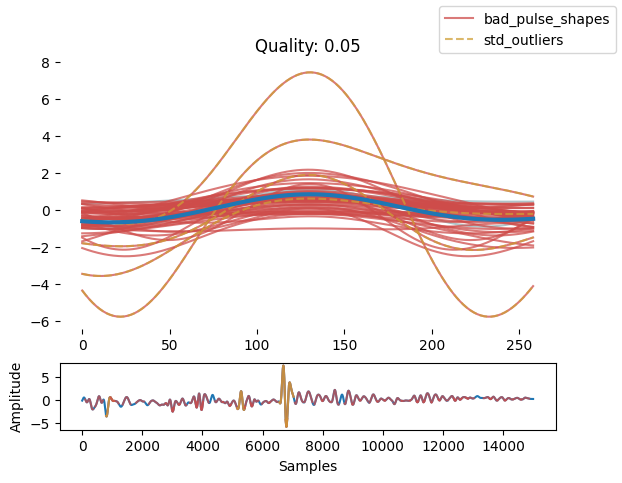

prominence value: 0.5


,feature,rr candidate median delta,rr_candidates_count,std,n peaks
0,RIFV_max,44.98,34.68,12.90,16
1,RIFV_min,44.90,37.35,13.27,17
2,RIFV_mas,39.13,29.13,16.11,13
3,AUDP,24.77,22.38,13.87,10
4,RIIV_upper,24.81,23.55,14.13,10
5,RIIV_lower,35.96,28.77,12.44,13
6,RIAV_ascending,28.95,25.94,7.82,11
7,RIAV_descending,26.20,25.82,8.73,11
8,STT,20.53,18.19,14.78,8
9,notch area ratio,29.94,27.42,9.84,12


[21.09375   30.9375    33.3984375]
[1.         0.80933095 0.66804026]
[21.796875 15.46875  31.640625]
[1.        0.8992146 0.6262085]
[21.09375   30.5859375 15.46875  ]
[1.         0.93852571 0.6452859 ]
[24.2578125 33.75      19.3359375]
[0.67304039 0.52266579 0.44958426]
[18.984375  24.9609375 40.4296875]
[1.         0.78908245 0.4909171 ]
[40.078125  17.9296875 33.75     ]
[1.         0.84375067 0.78263049]
[18.28125   24.2578125 33.3984375]
[1.         0.6165829  0.42503674]
[18.28125  24.609375 33.046875]
[1.         0.6375434  0.61120246]
[24.9609375 34.453125  36.9140625]
[1.         0.97456278 0.76407565]
[31.2890625 20.390625  41.8359375]
[1.         0.39103445 0.35916207]
[31.2890625 24.9609375 18.28125  ]
[1.         0.5482429  0.38770923]
[65.0390625 69.2578125 27.0703125]
[0.47047138 0.42310958 0.33022755]
[24.609375  18.6328125]
[1.         0.34292393]


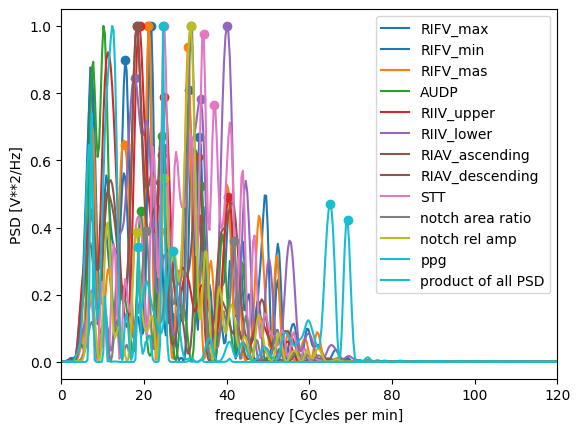

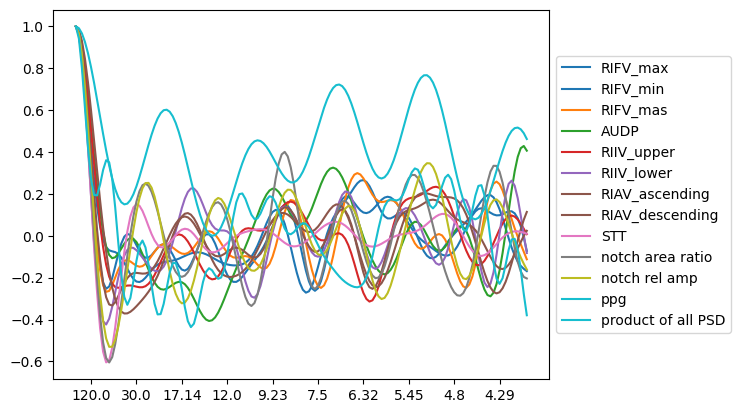

,original candidate,max psd freqs,RQIs,acf RRs,acf peak
RIFV_max,21.09,21.09,0.14,"[42.35, 16.74]","[0.01, 0.01]"
RIFV_min,21.80,21.80,0.17,[10.91],[0.12]
RIFV_mas,21.09,21.09,0.14,[16.36],[0.02]
AUDP,24.26,24.26,0.19,[11.08],[0.23]
RIIV_upper,18.98,18.98,0.17,"[12.63, 21.18]","[0.04, 0.01]"
RIIV_lower,40.08,40.08,0.11,[18.95],[0.23]
RIAV_ascending,18.28,18.87,0.23,"[10.59, 19.46]","[0.11, 0.11]"
RIAV_descending,18.28,18.28,0.14,[20.0],[0.09]
STT,24.96,24.96,0.10,"[36.0, 20.0, 11.8]","[0.15, 0.03, 0.03]"
notch area ratio,31.29,31.29,0.24,"[31.3, 15.32]","[0.25, 0.16]"


RIFV_max: [21.09 30.94 33.4 ][0.03173163 0.02568139 0.021198  ]
RIFV_min: [21.8  15.47 31.64][0.03588885 0.03227178 0.02247391]
RIFV_mas: [21.09 30.59 15.47][0.03145278 0.02951924 0.02029604]
AUDP: [24.26 33.75 19.34][0.03802291 0.02952761 0.02539892]
RIIV_upper: [18.98 24.96 40.43][0.03181348 0.02510345 0.01561778]
RIIV_lower: [40.08 17.93 33.75][0.02047166 0.01727297 0.01602174]
RIAV_ascending: [18.28 24.26 33.4 ][0.04293738 0.02647445 0.01824996]
RIAV_descending: [18.28 24.61 33.05][0.02630923 0.01677327 0.01608026]
STT: [24.96 34.45 36.91][0.02236331 0.02179445 0.01708726]
notch area ratio: [31.29 20.39 41.84][0.05172248 0.02022527 0.01857675]
notch rel amp: [31.29 24.96 18.28][0.04351171 0.02385499 0.01686989]
ppg: [65.04 69.26 27.07][0.02888143 0.02597397 0.0202721 ]
product of all PSD: [24.61 18.63][0.28203678 0.09671716]
[18.28125 22.5     28.125  ]
[1.         0.39621986 0.20607418]
[18.28125   22.5       28.4765625]
[1.         0.58052224 0.43109994]
[29.53125   38.671875  17

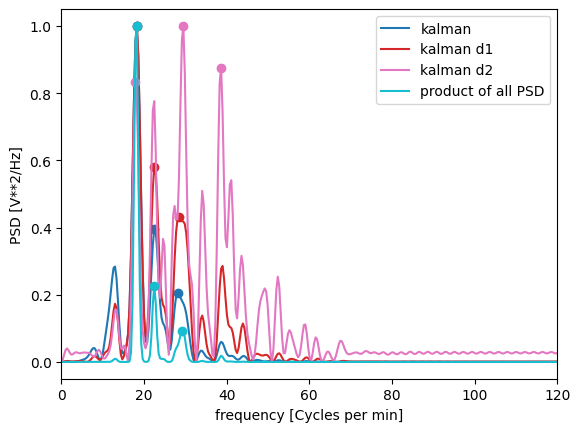

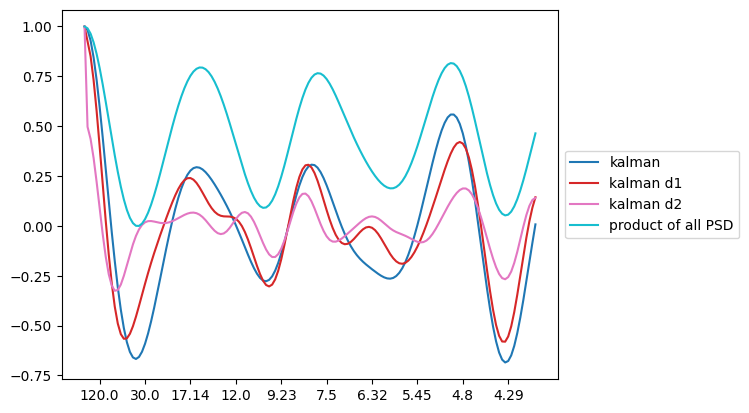

,original candidate,max psd freqs,RQIs,acf RRs,acf peak
kalman,18.28,18.28,0.39,[19.46],[0.29]
kalman d1,18.28,18.28,0.24,[20.57],[0.24]
kalman d2,29.53,29.53,0.12,"[13.58, 20.0, 32.73]","[0.07, 0.07, 0.02]"
product of all PSD,18.28,18.28,0.69,[18.95],[0.79]


kalman: [18.28 22.5  28.12][0.07983059 0.03163046 0.01645102]
kalman d1: [18.28 22.5  28.48][0.0499813  0.02901526 0.02154694]
kalman d2: [29.53 38.67 17.93][0.02523733 0.02210888 0.02105521]
product of all PSD: [18.28 22.5  29.18][0.19446837 0.04412984 0.01808693]
kalman seed:  20
harmonic result:  18.28125
RR kalman:  18.28125


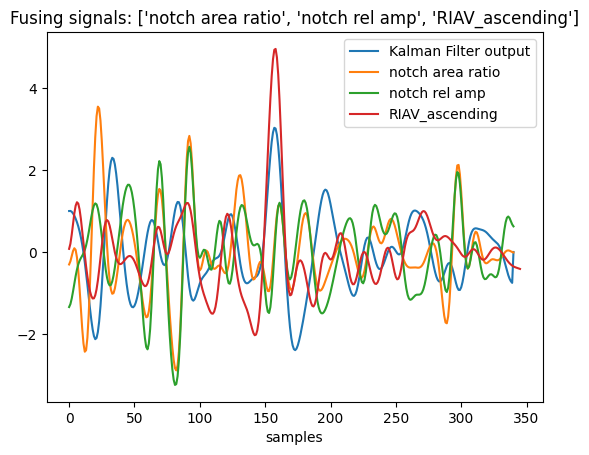

In [15]:
(
    frame_data,
    rr_candidate_merged,
    all_rr_candidates_list,
    feature_quality_list,
    meta,
    trial_summary_df
) = estimate_rr(
    trial_num=trial,
    frame_num=frame_num,
    params=params,
    dataset=dataset,
    show=True,
    save_fig=False,
    save_psd_fig=False,
    rr_seed=20
)

In [16]:
pd.DataFrame(frame_data)

,frame index,time start,time end,ppg,RR uncertainty panel (mean),RR uncertainty panelist D (mean),RR uncertainty panelist J (mean),RR uncertainty panelist O (mean),avg rr ref panelist,RR ref disagreement panelist (bpm),avg rr ref panelist D,RR ref disagreement panelist D (bpm),avg rr ref panelist J,RR ref disagreement panelist J (bpm),avg rr ref panelist O,RR ref disagreement panelist O (bpm),RR ref disagreement panel (bpm),avg rr ref panel,RR ref panel (mean),rr annot post,rr annot live,avg rr ref,RR ref (mean),RR ref disagreement (bpm),RR ref video problems panelist D,RR ref video problems panelist J,RR ref video problems panelist O,RR ref video problems panel,no hr ref,no rr ref,aliased,no ppg,clipping,HR ref (mean),Ref RR/HR (mean),HR estimated (mean),HR est reliable,HR disagreement of means,PPG quality,PPG noise peak f,PPG noise ratio,PPG noise mean Pxx
0,14,70,100,35000 -541273 35001 -541143 35002 -54104...,0.18,0.00,0.00,0.55,"{'D': 25.935752292935117, 'J': 29.267053559160...","{'D': nan, 'J': nan, 'O': nan}",25.94,NaN,29.27,NaN,13.57,NaN,15.69,22.93,22.93,22.93,21.81,22.37,22.93,1.12,,,,,False,False,False,False,False,84.73,0.27,117.19,True,32.46,0.05,79.73,4.19,8.79


In [17]:
df = pd.DataFrame(all_rr_candidates_list)

In [18]:
df.iloc[:22]['RR candidate']

0    34.68
1    37.35
2    29.13
3    22.38
4    23.55
5    28.77
6    25.94
7    25.82
8    18.19
9    27.42
10   31.89
11   41.39
12   44.98
13   44.90
14   39.13
15   24.77
16   24.81
17   35.96
18   28.95
19   26.20
20   20.53
21   29.94
Name: RR candidate, dtype: float64

In [19]:
# save ppg waveform to use for testing
# pd.DataFrame(frame_data[0]['ppg']).to_csv(f'ppg_kapiolanip1-{trial}-{frame_num[0]}.csv', index=False)